In [1]:
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.optimizers import Adam

import tensorflow_datasets as tfds

import numpy as np
import matplotlib.pyplot as plt

In [2]:
path = 'c:/Users/admin/Desktop/Dunhuang_dataset/'

train_images = tf.keras.utils.image_dataset_from_directory(path, image_size=(512, 512), batch_size=16)

Found 1291 files belonging to 6 classes.


In [3]:
train_images

<BatchDataset element_spec=(TensorSpec(shape=(None, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [4]:
for x, y in train_images.take(1):
    print(x.shape)

(16, 512, 512, 3)


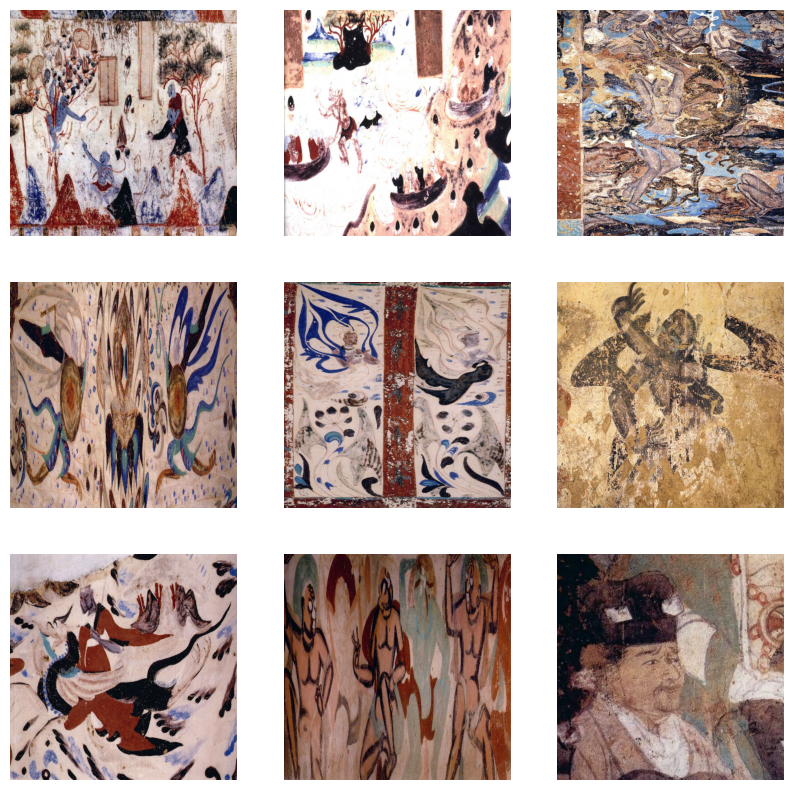

In [5]:
plt.figure(figsize=(10, 10))
for images, labels in train_images.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.axis("off")

In [6]:
normalization_layer = layers.Rescaling(1./255)
normalized_train_images = train_images.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_train_images))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.0 0.9411023


In [7]:
image_shape = (512, 512, 3)
batch_size = 16

In [8]:
class WGAN_GP():
    def __init__(self, input_shape):

        self.z_dim = 64
        self.input_shape = input_shape

        self.loss_critic = {}
        self.loss_gp = {}
        self.loss_generator = {}
        
        # critic
        self.n_critic = 5
        self.penalty_const = 10
        self.critic = self.build_critic()
        self.critic.trainable = False

        self.optimizer_critic = Adam(1e-4, 0.5, 0.9)

        # build generator pipeline with frozen critic
        self.generator = self.build_generator()
        critic_output = self.critic(self.generator.output)
        self.model = Model(self.generator.input, critic_output)
        self.model.compile(loss = self.wasserstein_loss,
                           optimizer = Adam(1e-4, 0.5, 0.9))
        self.critic.trainable = True
        
    def wasserstein_loss(self, y_true, y_pred):

        w_loss = -tf.reduce_mean(y_true*y_pred)

        return w_loss

    def build_generator(self):

        DIM = 64
        model = tf.keras.Sequential(name='Generator') 

        model.add(layers.Input(shape=[self.z_dim])) 

        model.add(layers.Dense(16*16*8*DIM))                                                
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        model.add(layers.Reshape((16,16,8*DIM)))                                            
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))               
        model.add(layers.Conv2D(8*DIM, 5, padding='same'))                                
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))               
        model.add(layers.Conv2D(4*DIM, 5, padding='same'))                                
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))                    
        model.add(layers.Conv2D(2*DIM, 5, padding='same'))                                 
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))                 
        model.add(layers.Conv2D(DIM, 5, padding='same'))                              
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())

        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))                   
        model.add(layers.Conv2D(image_shape[-1], 5, padding='same', activation='tanh'))   

        return model             
    
    def build_critic(self):

        DIM = 64
        model = tf.keras.Sequential(name='critics') 

        model.add(layers.Input(shape=self.input_shape)) 

        model.add(layers.Conv2D(1*DIM, 5, strides=2, padding='same', use_bias=False))    
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(2*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(4*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(8*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
        
        model.add(layers.Conv2D(16*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
        
        model.add(layers.Conv2D(32*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
        
        model.add(layers.Conv2D(64*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
     
        model.add(layers.Flatten()) 
        model.add(layers.Dense(1)) 

        return model     
    
 
    def gradient_loss(self, grad):

        loss = tf.square(grad)
        loss = tf.reduce_sum(loss, axis=np.arange(1,len(loss.shape)))
        loss = tf.sqrt(loss)
        loss = tf.reduce_mean(tf.square(loss - 1))
        loss = self.penalty_const * loss
        return loss

    def train_critic(self, real_images, batch_size):
        real_labels = tf.ones(batch_size)
        fake_labels = -tf.ones(batch_size)
                  
        g_input = tf.random.normal((batch_size, self.z_dim))
        fake_images = self.generator.predict(g_input, verbose=0)
        
        with tf.GradientTape() as gradient_tape,\
             tf.GradientTape() as total_tape:
            
            # forward pass
            pred_fake = self.critic(fake_images)
            pred_real = self.critic(real_images)
            
            # calculate losses
            loss_fake = self.wasserstein_loss(fake_labels, pred_fake)
            loss_real = self.wasserstein_loss(real_labels, pred_real)           
            
            # gradient penalty      
            epsilon = tf.random.uniform((batch_size,1,1,1))
            interpolates = epsilon*real_images + (1-epsilon)*fake_images
            gradient_tape.watch(interpolates)
            
            critic_interpolates = self.critic(interpolates)
            gradients_interpolates = gradient_tape.gradient(critic_interpolates, [interpolates])
            gradient_penalty = self.gradient_loss(gradients_interpolates)
     
            # total loss
            total_loss = loss_fake + loss_real + gradient_penalty
            
            # apply gradients
            gradients = total_tape.gradient(total_loss, self.critic.trainable_variables)
            
            self.optimizer_critic.apply_gradients(zip(gradients, self.critic.trainable_variables))

        return loss_fake, loss_real, gradient_penalty
                                                
    def train(self, data_generator, batch_size, steps, interval=100):

        val_g_input = tf.random.normal((batch_size, self.z_dim))
        real_labels = tf.ones(batch_size)

        for i in range(steps):
            for _ in range(self.n_critic):
                real_images = data_generator
                loss_fake, loss_real, gradient_penalty = self.train_critic(real_images, batch_size)
                critic_loss = loss_fake + loss_real
            # train generator
            g_input = tf.random.normal((batch_size, self.z_dim))
            g_loss = self.model.train_on_batch(g_input, real_labels)
            self.loss_gp[i] = gradient_penalty
            self.loss_critic[i] = critic_loss.numpy()
            self.loss_generator[i] = g_loss
            if i%interval == 0:
                msg = "Step {}: g_loss {:.4f} critic_loss {:.4f} critic fake {:.4f}  critic_real {:.4f} penalty {:.4f}"\
                .format(i, g_loss, critic_loss, loss_fake, loss_real, gradient_penalty)
                print(msg)

                fake_images = self.generator.predict(val_g_input, verbose=0)
                self.plot_images(fake_images)
                # self.plot_losses()

    def plot_images(self, images):   
        grid_row = 1
        grid_col = 6
        f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*3.5, grid_row*3.5))
        for row in range(grid_row):
            for col in range(grid_col):
                if self.input_shape[-1]==1:
                    axarr[col].imshow(images[col,:,:,0]*0.5+0.5, cmap='gray')
                else:
                    axarr[col].imshow(images[col]*0.5+0.5)
                axarr[col].axis('off') 
        plt.show()

    def plot_losses(self):
        fig, (ax1, ax2, ax3) = plt.subplots(3, sharex=True)
        fig.set_figwidth(10)
        fig.set_figheight(6)
        ax1.plot(list(self.loss_critic.values()), label='Critic loss', alpha=0.7)
        ax1.set_title("Critic loss")
        ax2.plot(list(self.loss_generator.values()), label='Generator loss', alpha=0.7)
        ax2.set_title("Generator loss")
        ax3.plot(list(self.loss_gp.values()), label='Gradient penalty', alpha=0.7)
        ax3.set_title("Gradient penalty")
        plt.xlabel('Steps')
        plt.show()

In [9]:
wgan = WGAN_GP(image_shape)

Step 0: g_loss 144.0773 critic_loss -686.5406 critic fake -435.2015  critic_real -251.3391 penalty 679.6348


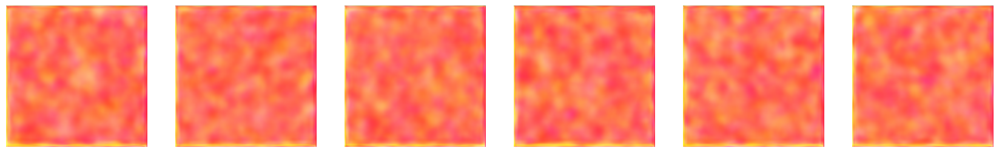

Step 100: g_loss -89.0147 critic_loss -173.5536 critic fake 77.9722  critic_real -251.5258 penalty 82.2848


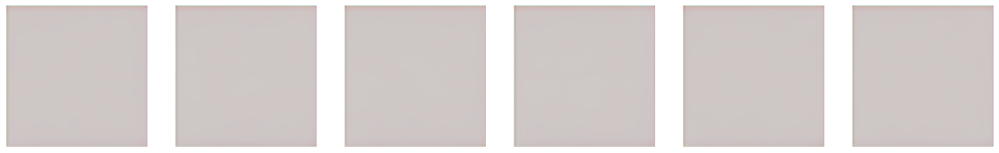

Step 200: g_loss -98.6711 critic_loss -214.7561 critic fake 131.0092  critic_real -345.7654 penalty 94.5358


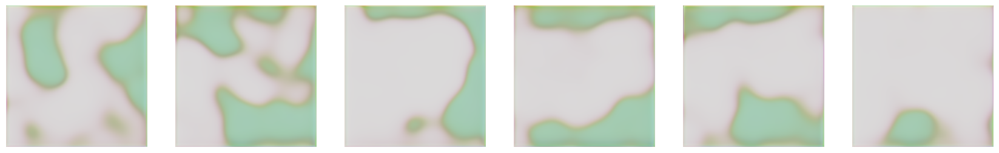

Step 300: g_loss 28.4994 critic_loss -137.4422 critic fake -38.5578  critic_real -98.8843 penalty 45.7970


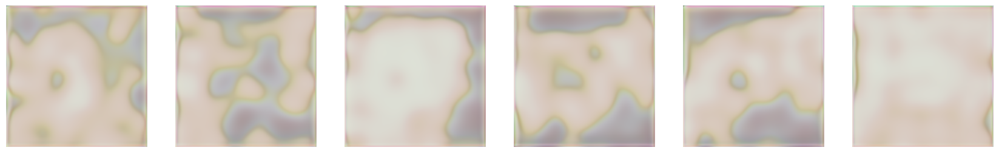

Step 400: g_loss 254.8703 critic_loss -188.1639 critic fake -101.6828  critic_real -86.4811 penalty 81.4505


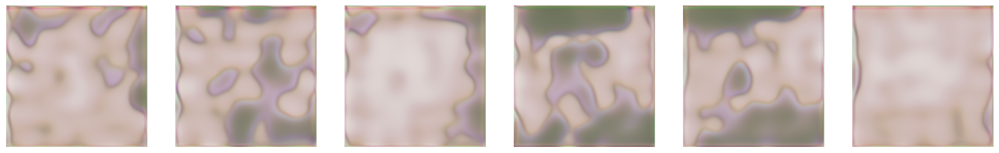

Step 500: g_loss 9.5813 critic_loss -143.7117 critic fake -4.0037  critic_real -139.7081 penalty 49.3164


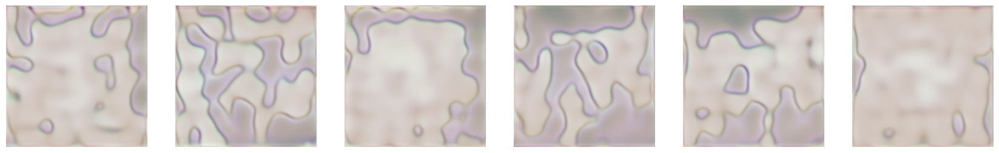

Step 600: g_loss -24.0590 critic_loss -141.8387 critic fake 25.0308  critic_real -166.8695 penalty 41.7143


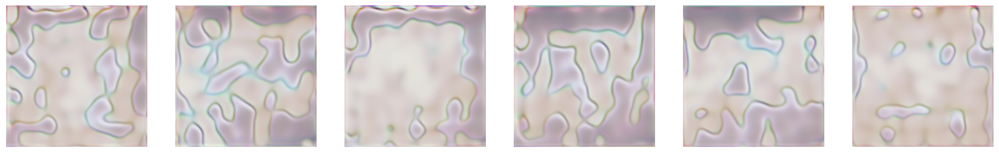

Step 700: g_loss 23.7800 critic_loss -146.1391 critic fake -31.3416  critic_real -114.7974 penalty 43.1244


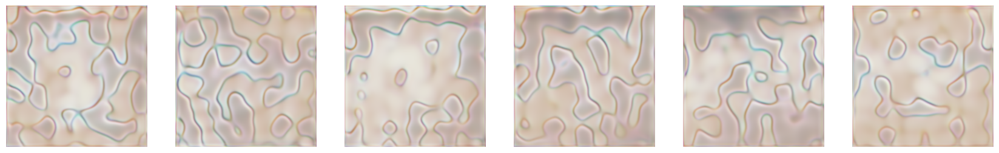

Step 800: g_loss 15.6341 critic_loss -154.8737 critic fake -12.2796  critic_real -142.5941 penalty 49.5090


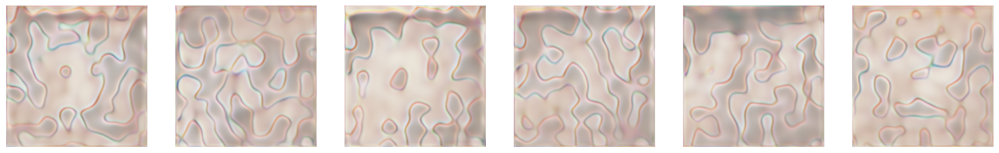

Step 900: g_loss 12.8119 critic_loss -149.4237 critic fake -8.0450  critic_real -141.3787 penalty 51.9274


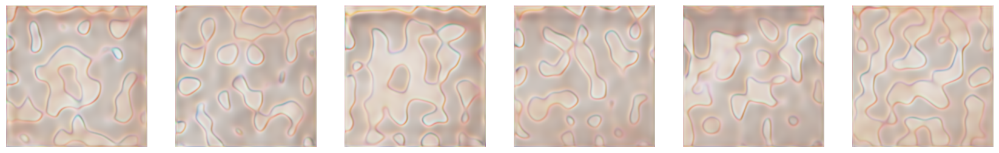

Step 1000: g_loss 12.8940 critic_loss -166.0679 critic fake -6.5490  critic_real -159.5190 penalty 70.3985


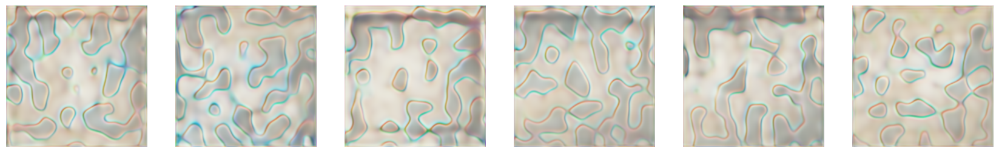

Step 1100: g_loss 11.0123 critic_loss -150.1234 critic fake -14.9133  critic_real -135.2101 penalty 49.6141


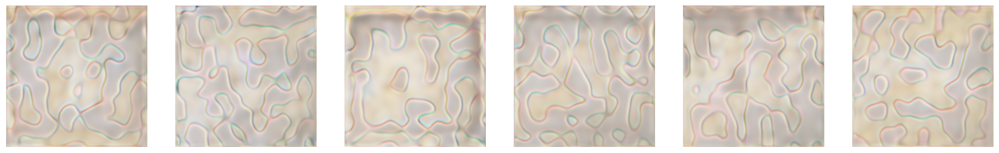

Step 1200: g_loss 30.4190 critic_loss -151.2479 critic fake -31.2105  critic_real -120.0375 penalty 47.3972


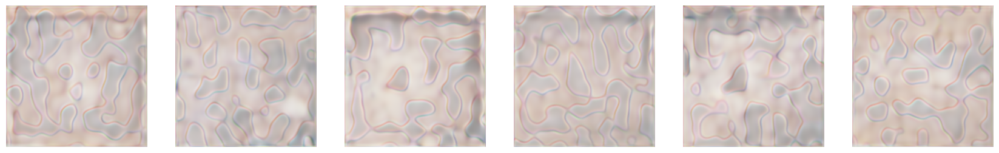

Step 1300: g_loss 5.9029 critic_loss -127.7566 critic fake -9.1475  critic_real -118.6091 penalty 30.7092


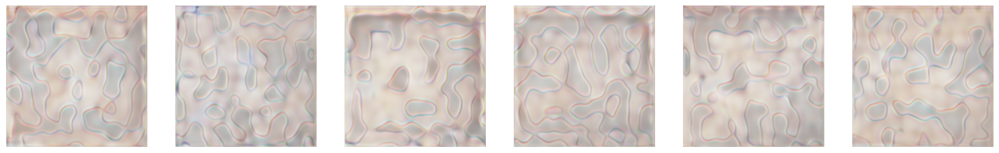

Step 1400: g_loss 2.6287 critic_loss -144.7822 critic fake -0.2027  critic_real -144.5795 penalty 45.8120


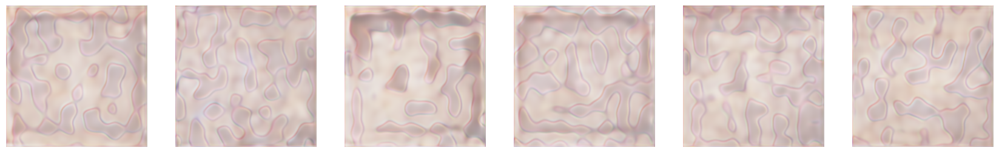

Step 1500: g_loss 9.5240 critic_loss -161.2500 critic fake -10.8320  critic_real -150.4180 penalty 57.1149


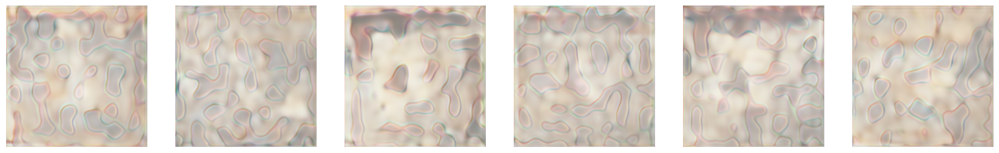

Step 1600: g_loss 12.3661 critic_loss -146.0388 critic fake -7.3198  critic_real -138.7190 penalty 54.5275


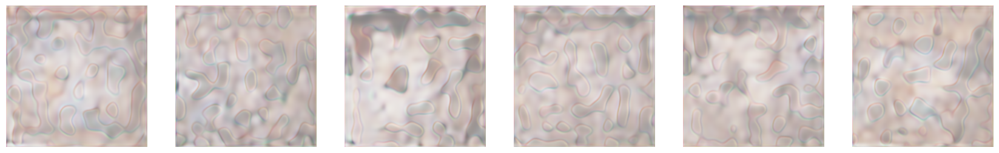

Step 1700: g_loss -5.1858 critic_loss -143.3938 critic fake 4.4793  critic_real -147.8731 penalty 47.2607


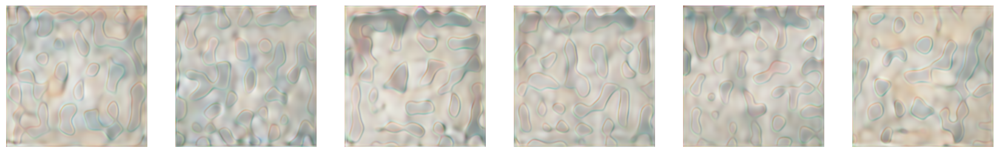

Step 1800: g_loss -7.2782 critic_loss -144.5390 critic fake 11.4820  critic_real -156.0210 penalty 49.4843


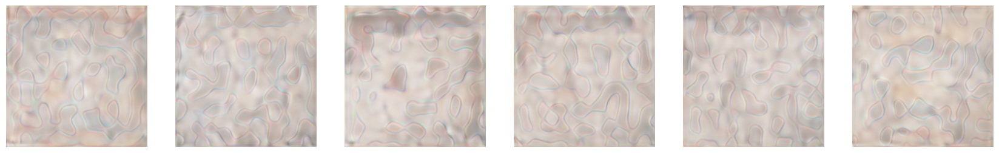

Step 1900: g_loss 1.5965 critic_loss -138.1684 critic fake 0.2034  critic_real -138.3718 penalty 49.5151


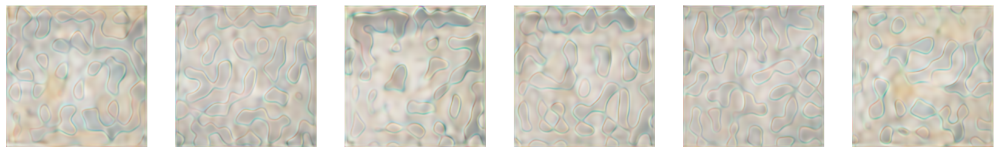

Step 2000: g_loss 12.5991 critic_loss -142.1148 critic fake -15.1157  critic_real -126.9991 penalty 36.4854


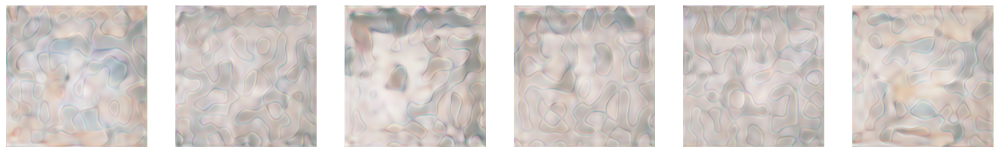

Step 2100: g_loss 5.8102 critic_loss -143.8247 critic fake -9.4194  critic_real -134.4052 penalty 48.7328


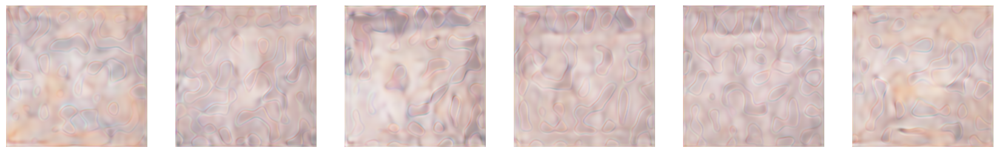

Step 2200: g_loss -28.3838 critic_loss -151.6407 critic fake 9.3356  critic_real -160.9763 penalty 42.9782


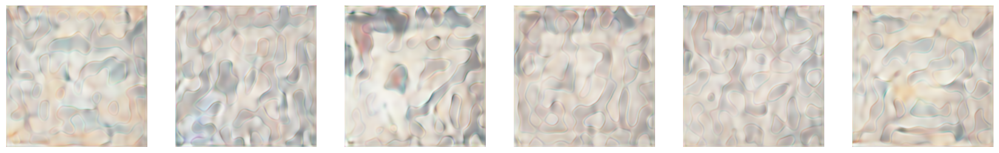

Step 2300: g_loss -3.3428 critic_loss -145.3943 critic fake 0.0310  critic_real -145.4253 penalty 48.6587


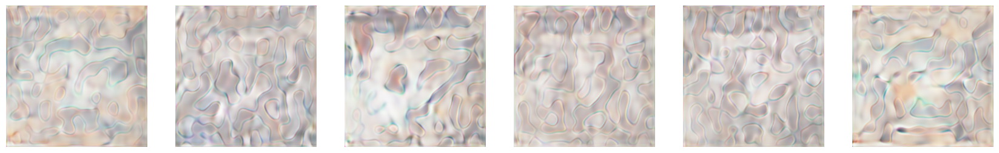

Step 2400: g_loss -1.3831 critic_loss -132.3814 critic fake 8.6089  critic_real -140.9903 penalty 39.9538


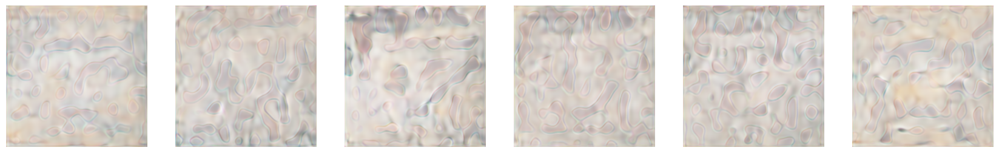

Step 2500: g_loss 6.6430 critic_loss -133.4532 critic fake -3.8117  critic_real -129.6416 penalty 41.8607


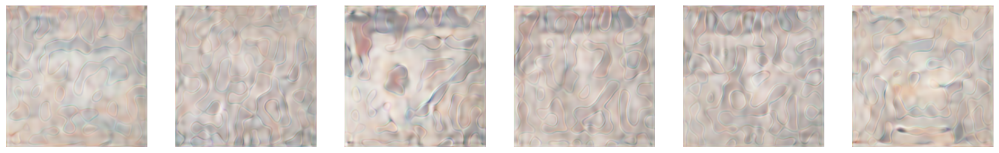

Step 2600: g_loss -8.0771 critic_loss -127.2089 critic fake 6.1603  critic_real -133.3692 penalty 41.5502


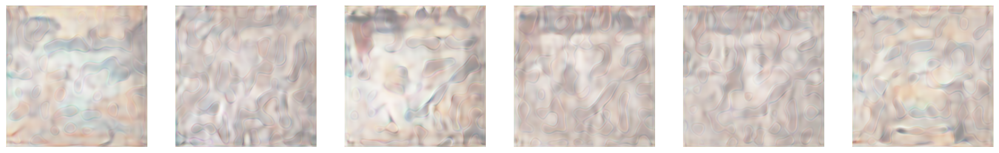

Step 2700: g_loss 0.0719 critic_loss -139.2464 critic fake -1.5247  critic_real -137.7218 penalty 53.3451


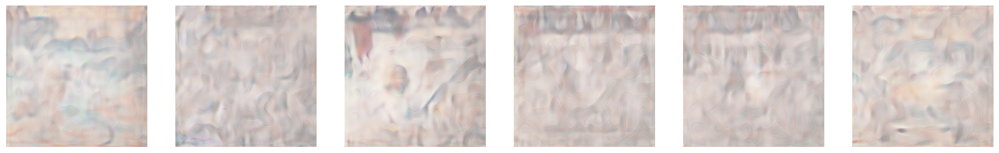

Step 2800: g_loss 12.6032 critic_loss -139.9039 critic fake -12.5669  critic_real -127.3370 penalty 46.8361


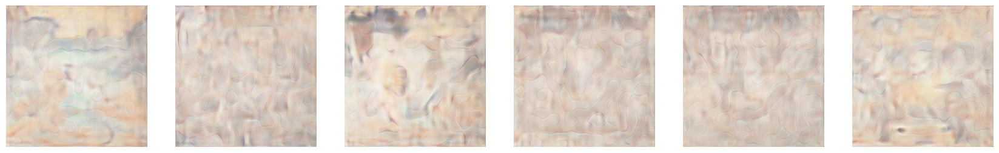

Step 2900: g_loss 4.5638 critic_loss -148.2121 critic fake -8.7568  critic_real -139.4553 penalty 58.0883


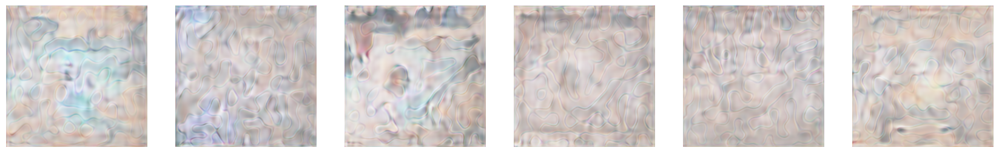

Step 3000: g_loss -4.4973 critic_loss -143.6980 critic fake 4.9412  critic_real -148.6392 penalty 52.8789


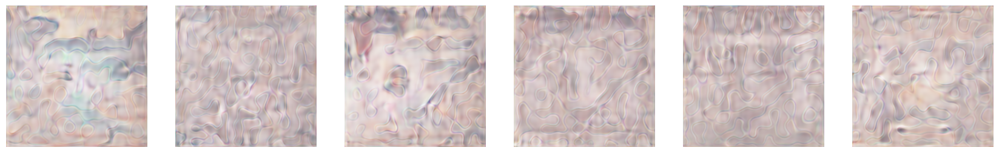

Step 3100: g_loss 0.6936 critic_loss -140.0498 critic fake -1.1183  critic_real -138.9315 penalty 45.4712


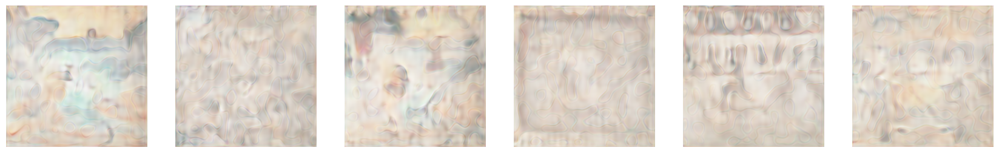

Step 3200: g_loss 2.6211 critic_loss -134.4170 critic fake 3.6183  critic_real -138.0353 penalty 41.4335


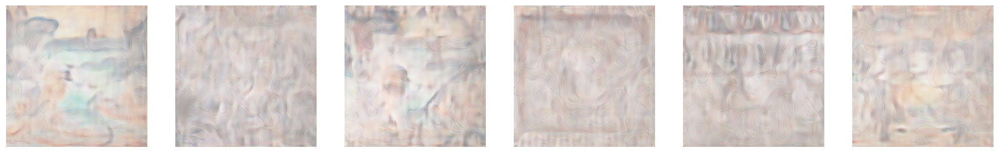

Step 3300: g_loss 0.6785 critic_loss -157.1080 critic fake -2.1599  critic_real -154.9481 penalty 58.7688


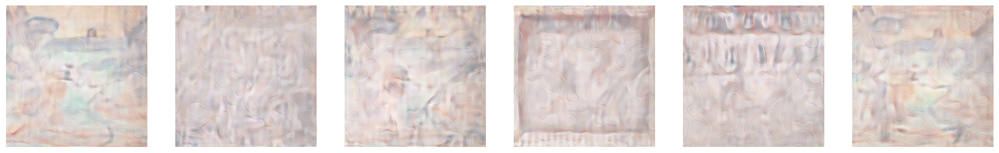

Step 3400: g_loss -3.7267 critic_loss -125.0529 critic fake -1.2970  critic_real -123.7558 penalty 32.8597


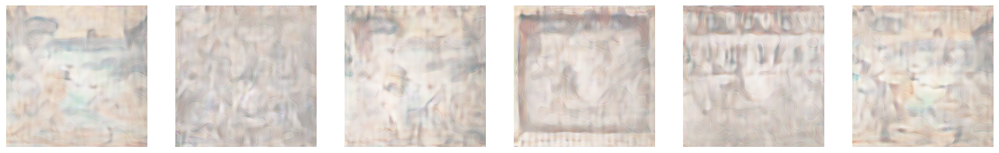

Step 3500: g_loss 1.4603 critic_loss -133.8950 critic fake -4.5340  critic_real -129.3611 penalty 38.2461


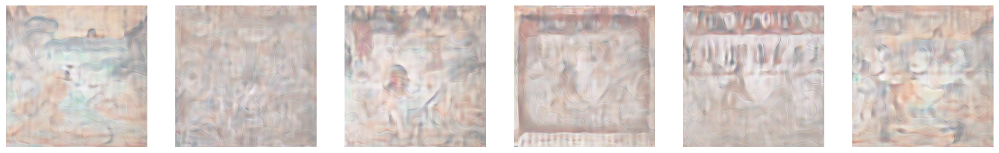

Step 3600: g_loss -5.0192 critic_loss -126.8680 critic fake 1.2413  critic_real -128.1093 penalty 33.1701


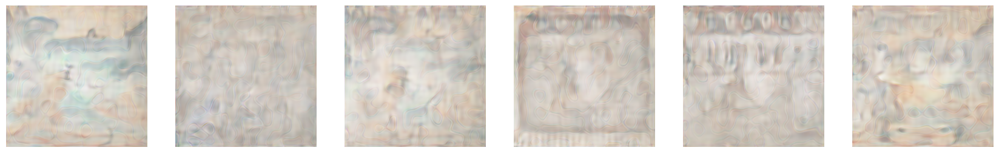

Step 3700: g_loss 9.6082 critic_loss -146.6836 critic fake -5.3845  critic_real -141.2991 penalty 54.5652


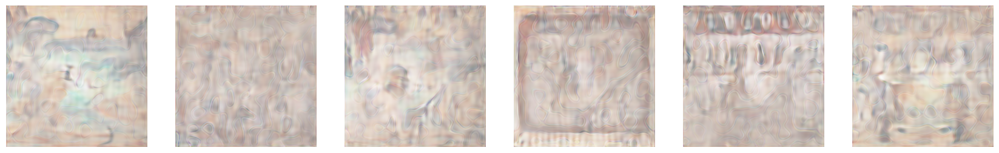

Step 3800: g_loss -2.0779 critic_loss -129.9402 critic fake -6.7130  critic_real -123.2271 penalty 40.3314


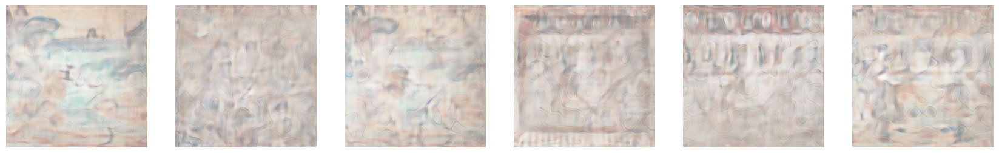

Step 3900: g_loss 2.2087 critic_loss -132.4644 critic fake -5.8027  critic_real -126.6616 penalty 49.3646


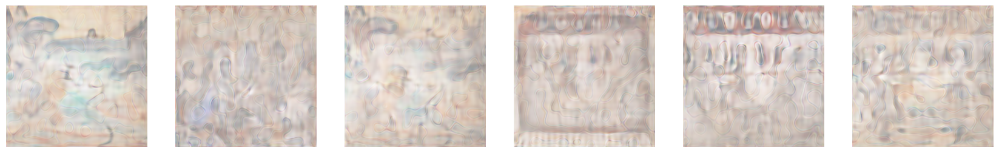

Step 4000: g_loss -3.7076 critic_loss -132.5604 critic fake -1.9663  critic_real -130.5941 penalty 35.5728


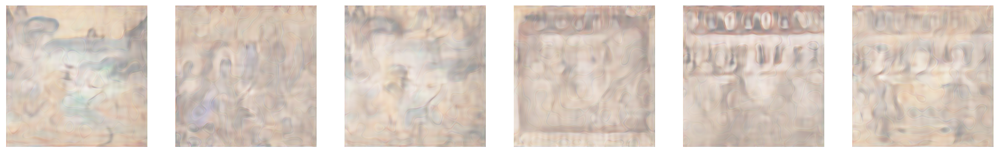

Step 4100: g_loss -0.9302 critic_loss -135.8848 critic fake 1.9353  critic_real -137.8201 penalty 50.1978


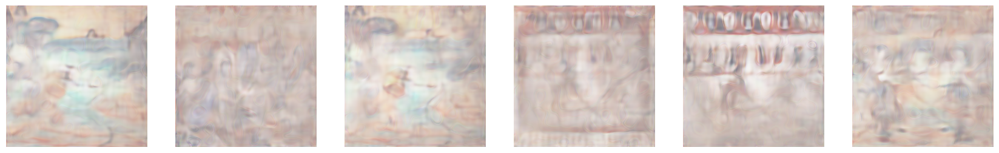

Step 4200: g_loss 6.5376 critic_loss -129.7932 critic fake -0.4566  critic_real -129.3366 penalty 45.5563


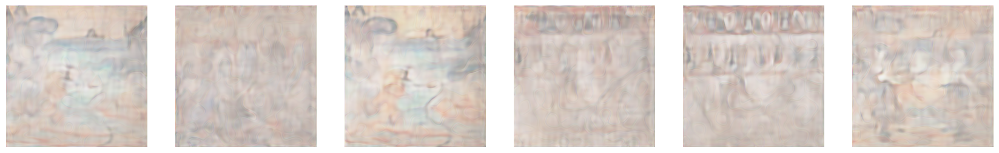

Step 4300: g_loss 2.0881 critic_loss -127.3716 critic fake -6.5960  critic_real -120.7756 penalty 37.6654


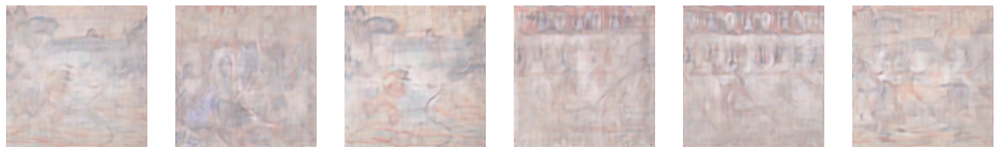

Step 4400: g_loss 2.5997 critic_loss -127.3653 critic fake -0.8429  critic_real -126.5225 penalty 41.9156


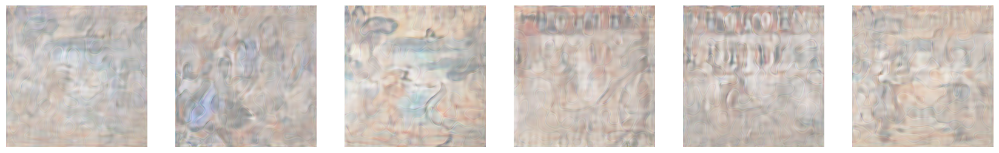

Step 4500: g_loss 8.8828 critic_loss -140.2659 critic fake -4.0130  critic_real -136.2529 penalty 63.5312


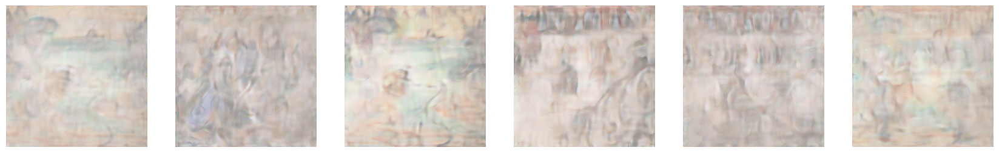

Step 4600: g_loss 4.9448 critic_loss -124.5346 critic fake 1.2566  critic_real -125.7912 penalty 42.7594


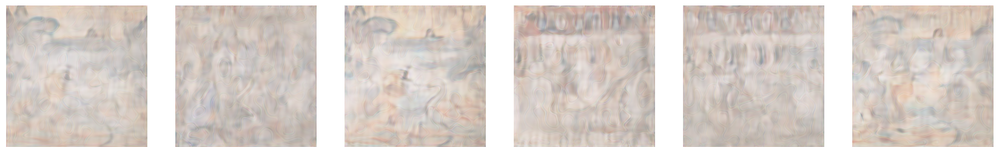

Step 4700: g_loss 7.2732 critic_loss -131.9624 critic fake -6.8406  critic_real -125.1218 penalty 38.2242


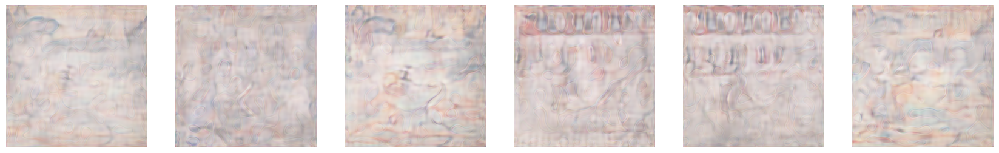

Step 4800: g_loss 0.0467 critic_loss -125.2138 critic fake 0.2543  critic_real -125.4682 penalty 44.1011


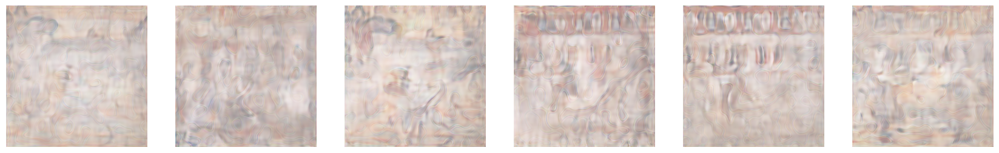

Step 4900: g_loss -1.4576 critic_loss -128.5787 critic fake 2.6022  critic_real -131.1810 penalty 49.9443


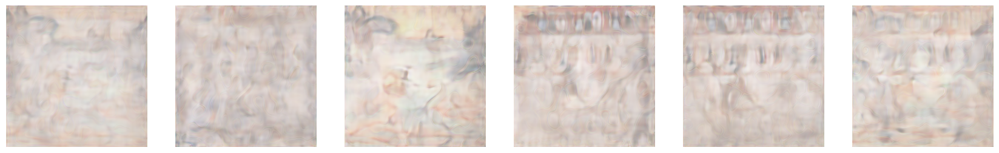

Step 5000: g_loss -0.3479 critic_loss -128.6873 critic fake 2.1750  critic_real -130.8623 penalty 30.2356


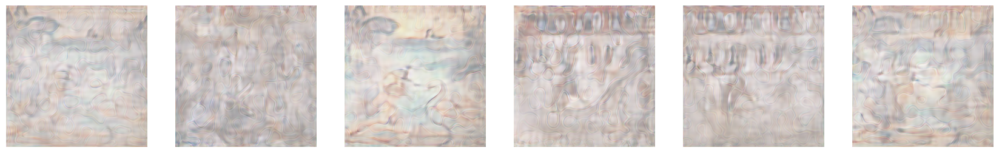

KeyboardInterrupt: 

In [10]:
wgan.train(image_batch, 16, 50000, 100)

In [ ]:
wgan.train(image_batch, 16, 50000, 100)

In [ ]:
wgan.model.summary()

In [ ]:
wgan.generator.summary()

In [ ]:
wgan.critic.summary()

In [11]:
wgan.generator.save_weights('wgan_gp_dunhuang_512_v3.weights')

Load model and interpolate

In [ ]:
wgan.generator.load_weights('wgan_gp_dunhuang_512_v3.weights')

In [ ]:
z = tf.random.normal((6, 64))
generated_images = wgan.generator.predict(z)
wgan.plot_images(generated_images)

In [ ]:
for i in range(20):
    z = tf.random.normal((20, 64))
    images = wgan.generator.predict(z, verbose=0)
    
    grid_row = 1
    grid_col = 20
    f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*4, grid_row*4))
    for row in range(grid_row):
        for col in range(grid_col):
            axarr[col].imshow(images[col]*0.5+0.5)
            axarr[col].axis('off')
    plt.show()

In [ ]:
def interpolate_points(p1, p2, n_steps=10):
# interpolate ratios between the points
    ratios = np.linspace(0, 1, num=n_steps)
# linear interpolate vectors
    vectors = list()
    for ratio in ratios:
        v = (1.0 - ratio) * p1 + ratio * p2
        vectors.append(v)
    return np.asarray(vectors)

In [ ]:
def plot_generated(images, n):
    plt.figure(figsize=(100,100))
    for i in range(n):
        plt.subplot(1, n, 1+i)
        plt.axis('off')
        plt.imshow(images[i,:,:]*0.5+0.5)
    plt.show()

In [ ]:
def save_generated(images, n, name):
    plt.figure(figsize=(100,100))
    for i in range(n):
        plt.clf()
        plt.axis('off')
        plt.imshow(images[i,:,:]*0.5+0.5)
        plt.savefig('./dunhuang/image_{}_{}.jpg'.format(name, i))

In [ ]:
points_num = 36
interpolated_steps = 2
points = (np.random.randn(points_num*64)).reshape((points_num,64))
for i in range(points_num-1):
    interpolated = interpolate_points(points[i], points[i+1], interpolated_steps)
    images = wgan.generator.predict(tf.convert_to_tensor(interpolated))
    # plot_generated(images, interpolated_steps)
    save_generated(images, interpolated_steps, i)